In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

import anndata as ad
import scanpy as sc

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from umap import UMAP


from scroutines import basicu
from scroutines import powerplots
from scroutines.miscu import is_in_polygon

import utils_merfish
from merfish_datasets import merfish_datasets
from merfish_genesets import get_all_genesets

import importlib
importlib.reload(powerplots)
importlib.reload(utils_merfish)

<module 'utils_merfish' from '/u/project/zipursky/f7xiesnm/v1-bb/v1/myvisctx/analysis_merfish/utils_merfish.py'>

In [2]:
np.random.seed(0)

In [3]:
def binning_pipe(adata, n=20, layer='ljnorm', bin_type='depth_bin'):
    """
    """
    assert bin_type in ['depth_bin', 'width_bin']
    # bin it 
    depth_bins, depth_binned = utils_merfish.binning(adata.obs['depth'].values, n)
    width_bins, width_binned = utils_merfish.binning(adata.obs['width'].values, n)

    norm_ = pd.DataFrame(adata.layers[layer], columns=adata.var.index)
    norm_['depth_bin'] = depth_binned
    norm_['width_bin'] = width_binned
    
    norm_mean = norm_.groupby(bin_type).mean(numeric_only=True)
    norm_sem  = norm_.groupby(bin_type).sem(numeric_only=True)
    norm_std  = norm_.groupby(bin_type).std(numeric_only=True)
    norm_n    = norm_[bin_type].value_counts(sort=False)

    return norm_mean, norm_sem, norm_std, norm_n, depth_binned, width_binned, depth_bins, width_bins

def binning_pipe2(adata, col_to_bin, bins=None, n=20, layer='ljnorm',):
    """
    """
    if bins is None:
        # bin it 
        bins, binned = utils_merfish.binning(adata.obs[col_to_bin].values, n)
    else:
        binned = pd.cut(adata.obs[col_to_bin].values, bins=bins)

    norm_ = pd.DataFrame(adata.layers[layer], columns=adata.var.index)
    norm_['thebin'] = binned
    
    norm_mean = norm_.groupby('thebin').mean(numeric_only=True)
    norm_sem  = norm_.groupby('thebin').sem(numeric_only=True)
    norm_std  = norm_.groupby('thebin').std(numeric_only=True)
    norm_n    = norm_['thebin'].value_counts(sort=False)

    return norm_mean, norm_sem, norm_std, norm_n, binned, bins 

In [4]:
genesets = get_all_genesets()
genesets

{'a': array(['Met', '6530403H02Rik', 'Rhbdl3', 'Adamts2', 'Cdh13', 'Col23a1',
        'Vwc2l', 'Syt10', 'Kcnn3', 'Arhgef28', 'Pcdh19', 'Pakap', 'Ikzf2',
        'Nckap5', 'Dpyd', 'Gpc5', 'Slc6a7', 'Igsf11', 'Glis3', 'Ttc28',
        'Tenm1', 'Syt17', 'Robo1', 'Sema6a', 'Otof', 'Eda', 'Plxna1',
        'Tox3', 'Itga8', 'Kcnk13', 'Wnt4', 'Sdk2', 'Pdzrn4', 'Plxnd1',
        'Ryr3', 'Necab1', 'Camk2d', 'Iqgap2', 'Pdgfc', 'Gabrg3', 'Dscaml1',
        'Reln', 'Npas3', 'Cntn5', 'Rfx3', 'Grm1', 'Kirrel3', 'Nfib',
        'Fkbp5', 'Zfp608', 'Meis2', 'Mdga1', 'Tiam1', 'Grb14', 'Nkain3',
        'Epha6', 'Cacna1h', 'Pde1a', 'Nr3c2', 'Matn2', 'Tmem150c',
        'Adamts17', 'Ldb2', 'Egfem1'], dtype=object),
 'b': array(['Grm8', 'Galnt17', 'Epha3', 'Rgs8', 'Sox5', 'Zfp804b', 'Tmeff1',
        'Fstl5', 'Cdh4', 'Kcnip3', 'Myh9', 'Sh3pxd2b', 'Klhl1', 'Trpc6',
        'Sema4a', 'Tafa1', 'Sertm1', 'Nrp1', 'Col26a1', 'Mas1', 'Igfn1',
        'Npas4', 'Scg3', 'Nptx2', 'Bdnf', 'Phf21b', 'Nell1', 'Baz1a',
 

In [5]:
directories = merfish_datasets
print(merfish_datasets)

ddir = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/data/merfish/organized" 
fout = os.path.join(ddir, 'P28NRDR_v1nonv1_merged_240520.h5ad')
!ls $ddir/*240411.h5ad 

{'P14NRa_ant': 'merfish_06142023/ant/region0', 'P28NRa_ant': 'merfish_06142023/ant/region1', 'P14NRa_pos': 'merfish_06142023/pos/region0', 'P28NRa_pos': 'merfish_06142023/pos/region1', 'P21NRa_ant': 'merfish_20231114/region0', 'P21DRa_ant': 'merfish_20231114/region2', 'P28DRa_ant': 'merfish_20231114/region1', 'P21NRa_pos': 'merfish_20231120/region0', 'P21DRa_pos': 'merfish_20231120/region1', 'P28DRa_pos': 'merfish_20231120/region2', 'P14NRb_ant': 'merfish_202404051211/region_0', 'P28NRb_ant': 'merfish_202404051211/region_1', 'P14NRb_pos': 'merfish_202404051214/region_0', 'P28NRb_pos': 'merfish_202404051214/region_1', 'P21NRb_ant': 'merfish_202404091526/region_2', 'P21DRb_ant': 'merfish_202404091526/region_1', 'P28DRb_ant': 'merfish_202404091526/region_0', 'P21NRb_pos': 'merfish_202404091601/region_0', 'P21DRb_pos': 'merfish_202404091601/region_2', 'P28DRb_pos': 'merfish_202404091601/region_1', 'P14NR_ant': 'merfish_06142023/ant/region0', 'P28NR_ant': 'merfish_06142023/ant/region1', 'P1

In [6]:
%%time
names = [
    'P28NR_ant', 
    'P28NR_pos',
    
    'P28NRb_ant', 
    'P28NRb_pos',
    
    'P28DR_ant', 
    'P28DR_pos',
    
    'P28DRb_ant', 
    'P28DRb_pos',
]

alldata = {}
for name in names:
    if 'P28NRb_ant' in name:
        alldata[name] = ad.read(os.path.join(ddir, f'{name}_ctxglut_240506.h5ad'))
    elif 'b' in name:
        alldata[name] = ad.read(os.path.join(ddir, f'{name}_ctxglut_240429.h5ad'))
    else:
        alldata[name] = ad.read(os.path.join(ddir, f'{name}_ctxglut_240411.h5ad'))
    print(name, len(alldata[name]))
    


P28NR_ant 20466
P28NR_pos 25253
P28NRb_ant 40280
P28NRb_pos 85945
P28DR_ant 10678
P28DR_pos 17553
P28DRb_ant 42571
P28DRb_pos 28026
CPU times: user 926 ms, sys: 4.09 s, total: 5.01 s
Wall time: 33.8 s


In [7]:
mean_total_rna_target = 250
for i, name in enumerate(names):
    adatasub = alldata[name].copy()
    
    adatasub.obs['sample'] = name
    
    norm_cnts = adatasub.layers['norm']
    mean_per_batch = np.nanmean(norm_cnts.sum(axis=1))
    adatasub.layers['jnorm']  = norm_cnts*(mean_total_rna_target/mean_per_batch)
    adatasub.layers['ljnorm'] = np.log2(1+adatasub.layers['jnorm'])
    
    adatasub.obs['norm_transcript_count']  = adatasub.layers['norm'].sum(axis=1)
    adatasub.obs['jnorm_transcript_count'] = adatasub.layers['jnorm'].sum(axis=1)

    alldata[name] = adatasub

In [8]:
22**0.2, 2**1

(1.8556007362580844, 2)

P28NR_ant


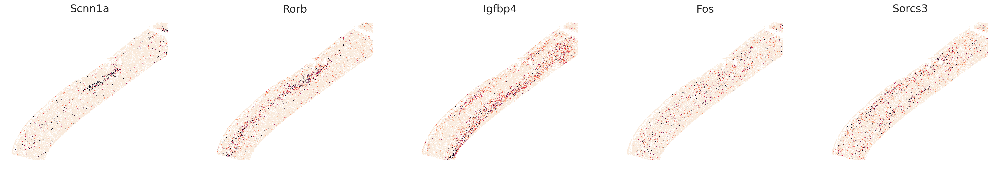

P28NR_pos


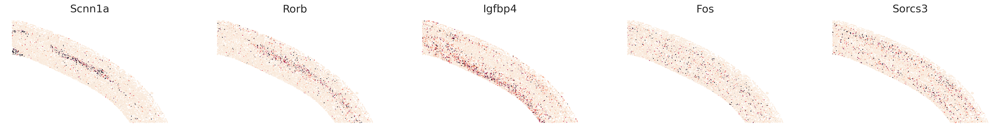

P28NRb_ant


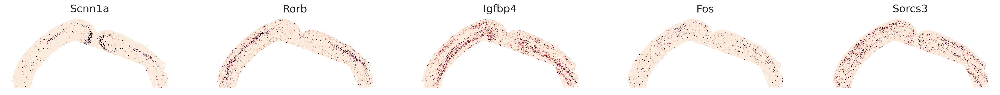

P28NRb_pos


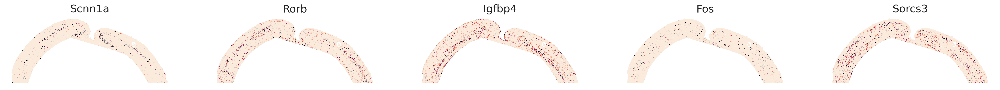

P28DR_ant


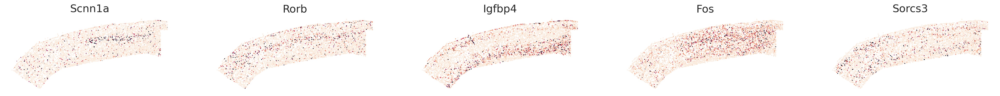

P28DR_pos


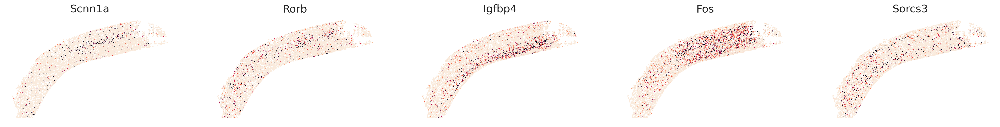

P28DRb_ant


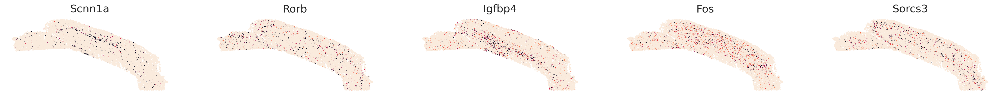

P28DRb_pos


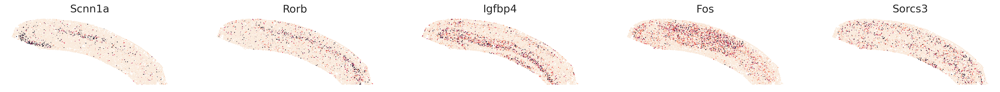

In [9]:
for name, adata in alldata.items():
    print(name)
    gns = ['Scnn1a', 'Rorb', 'Igfbp4', 'Fos', 'Sorcs3']
    x = adata.obs['x']
    y = adata.obs['y']
    n = len(gns)

    fig, axs = plt.subplots(1,n,figsize=(n*6,1*5))
    for ax, gn in zip(axs, gns):
        g = adata[:,gn].layers['jnorm']
        utils_merfish.st_scatter_ax(fig, ax, x, y, gexp=g, s=2, title=gn)
    plt.show()

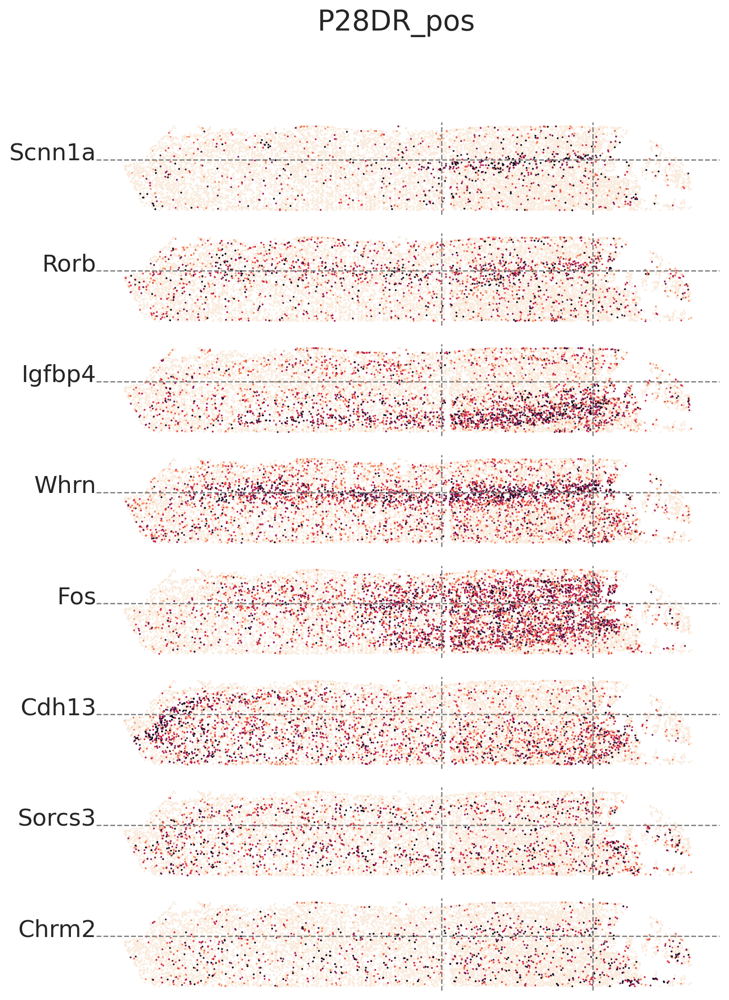

In [10]:
gns = ['Scnn1a', 'Rorb', 'Igfbp4', 'Whrn', 'Fos', 'Cdh13', 'Sorcs3', 'Chrm2',]# 'Astn2', 'Fos']

name = 'P28DR_pos' 
adata = alldata[name]
bound_l, bound_r, bound_d = adata.uns['bound_lrd']
x =  adata.obs['width']
y = -adata.obs['depth']
n = len(gns)

fig, axs = plt.subplots(n,1,figsize=(1*10,n*1.5))
fig.suptitle(name)
for ax, gn in zip(axs, gns):
    # gn = 'Scnn1a'
    g = np.log2(1+adata[:,gn].layers['jnorm']).reshape(-1,)
    
    vmax = np.percentile(g, 99)
    vmin = np.percentile(g,  5)
    cond = g > 1e-5
    
    utils_merfish.st_scatter_ax(fig, ax, x[~cond], y[~cond], gexp=g[~cond], s=2, title='', vmin=vmin, vmax=vmax, cmap='rocket_r') #, axis_off=False)
    utils_merfish.st_scatter_ax(fig, ax,  x[cond],  y[cond],  gexp=g[cond], s=2, title='', vmin=vmin, vmax=vmax, cmap='rocket_r') #, axis_off=False)
    
    ax.set_title(gn, loc='left', ha='right', y=0.5)
    ax.axhline(-bound_d, linestyle='--', linewidth=1, color='gray', zorder=2)
    ax.axvline( bound_l, linestyle='--', linewidth=1, color='gray', zorder=2)
    ax.axvline( bound_r, linestyle='--', linewidth=1, color='gray', zorder=2)
    # ax.grid(True)
    # ax.axis('on')
    
plt.show()

# do a clustering together
- abc genes

In [11]:
agenes = genesets['a']
bgenes = genesets['b']
cgenes = genesets['c']
iegs   = genesets['i']
up_agenes = genesets['a_up']
abcgenes = np.hstack([agenes, bgenes, cgenes])
len(abcgenes)

170

In [12]:
agenes_idx = basicu.get_index_from_array(adata.var.index.values, agenes)
bgenes_idx = basicu.get_index_from_array(adata.var.index.values, bgenes)
cgenes_idx = basicu.get_index_from_array(adata.var.index.values, cgenes)
igenes_idx = basicu.get_index_from_array(adata.var.index.values, iegs)

In [13]:
# cluster V1 L2/3 only
adata_merged = []
for i, name in enumerate(names):
    adatasub = alldata[name].copy()
    # # select L2/3 only
    # adatasub = adatasub[adatasub.obs['depth'] < 400]
    if i == 0:
        genes = adatasub.var.index.values
    else:
        np.all(genes == adatasub.var.index.values)
        

    adatasub.obs.index = adatasub.obs.index + '_' + name
    adatasub.obs['sample'] = name
    adatasub.obs['depth_show'] = -adatasub.obs['depth'].values - i*1500 # name
    adatasub.obs['depth_show2'] = -adatasub.obs['depth'].values - i*500 # name
    adatasub.obs['width_show'] =  adatasub.obs['width'].values - np.min(adatasub.obs['width'].values)   # name
    
    
    l, r, d = adatasub.uns['bound_lrd']
    width = adatasub.obs['width'].values
    width_norm = (width-l)/np.abs(r-l)
    adatasub.obs['width_norm'] = width_norm
    
    
    
    adata_merged.append(adatasub)
    print(adatasub.shape)
    # break
    
adata_merged = ad.concat(adata_merged)
adata_merged_abcgenes = adata_merged[:,abcgenes].copy()

adata_merged, adata_merged_abcgenes

(20466, 500)
(25253, 500)
(40280, 500)
(85945, 500)
(10678, 500)
(17553, 500)
(42571, 500)
(28026, 500)


(AnnData object with n_obs × n_vars = 270772 × 500
     obs: 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'PolyT_raw', 'PolyT_high_pass', 'DAPI_raw', 'DAPI_high_pass', 'gncov', 'gnnum', 'fpcov', 'x', 'y', 'depth', 'width', 'inside_v1l23', 'sample', 'norm_transcript_count', 'jnorm_transcript_count', 'depth_show', 'depth_show2', 'width_show', 'width_norm'
     obsm: 'blanks', 'pca'
     layers: 'norm', 'jnorm', 'ljnorm',
 AnnData object with n_obs × n_vars = 270772 × 170
     obs: 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'PolyT_raw', 'PolyT_high_pass', 'DAPI_raw', 'DAPI_high_pass', 'gncov', 'gnnum', 'fpcov', 'x', 'y', 'depth', 'width', 'inside_v1l23', 'sample', 'norm_transcript_count', 'jnorm_transcript_count', 'depth_show', 'depth_show2', 'width_show', 'width

# visualize FISH

In [14]:
adata = adata_merged

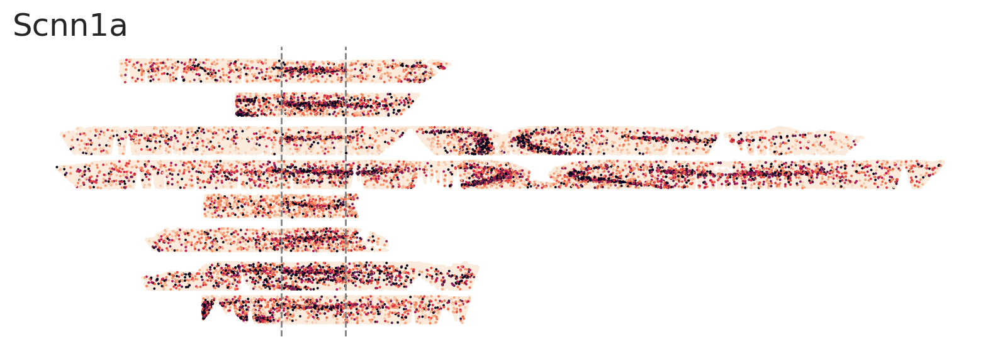

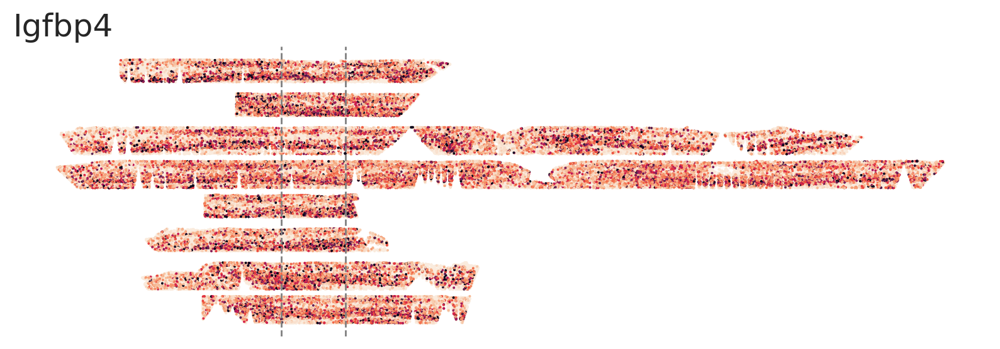

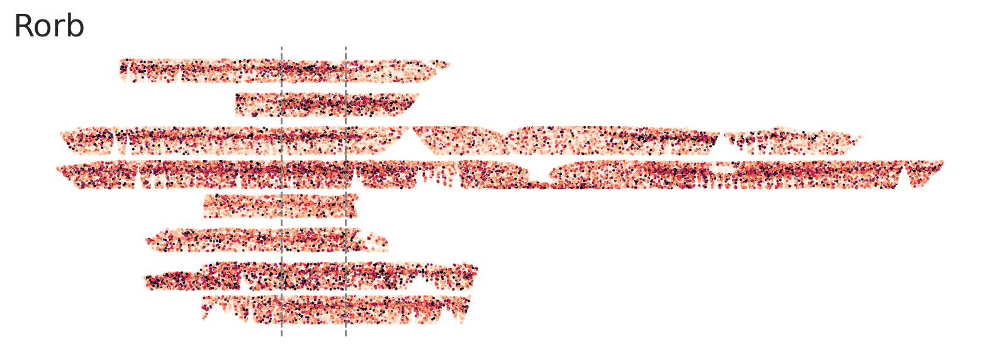

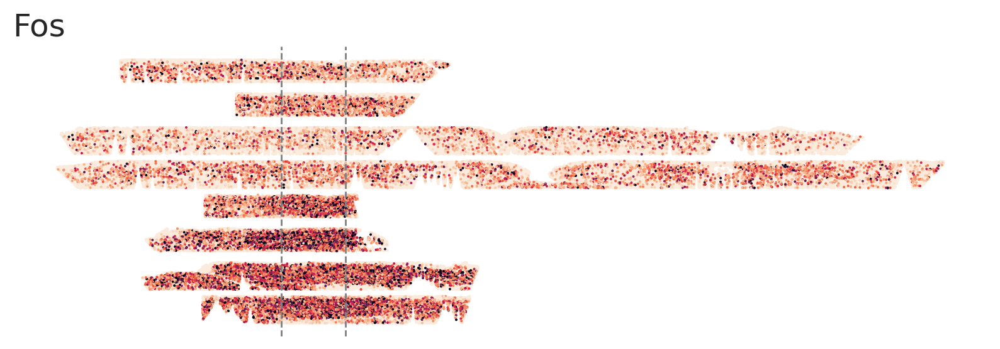

In [15]:
# check
gns = ['Scnn1a', 'Igfbp4', 'Rorb', 'Fos', ]
x =  adata.obs['width_norm']
y =  adata.obs['depth_show']
n = len(gns)

for gn in gns:
    fig, ax = plt.subplots(1,1,figsize=(1*10,1*3))
    g = adata[:,gn].layers['jnorm'].reshape(-1,)
    
    vmax = np.percentile(g, 99)
    vmin = np.percentile(g,  5)
    cond = g > 1e-5
    
    utils_merfish.st_scatter_ax(fig, ax, x[~cond], y[~cond], gexp=g[~cond], s=2, title='', vmin=vmin, vmax=vmax, cmap='rocket_r') #, axis_off=False)
    utils_merfish.st_scatter_ax(fig, ax,  x[cond],  y[cond],  gexp=g[cond], s=2, title='', vmin=vmin, vmax=vmax, cmap='rocket_r') #, axis_off=False)
    ax.set_title(gn, loc='left')
    ax.set_aspect('auto')
    ax.axvline(0, linewidth=1, color='gray', linestyle='--')
    ax.axvline(1, linewidth=1, color='gray', linestyle='--')
    
    # ax.grid(True)
    # ax.axis('on')
    
plt.show()

(93905,)
(93905,)
(93905,)
(93905,)


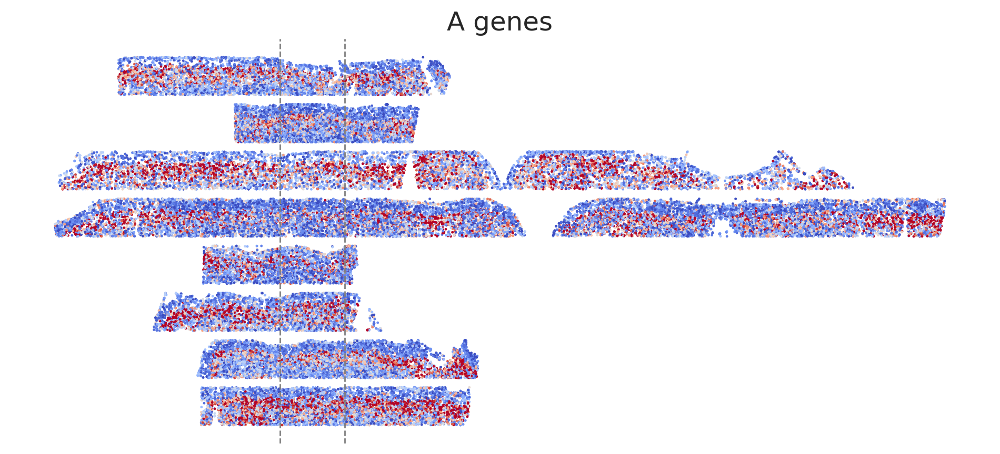

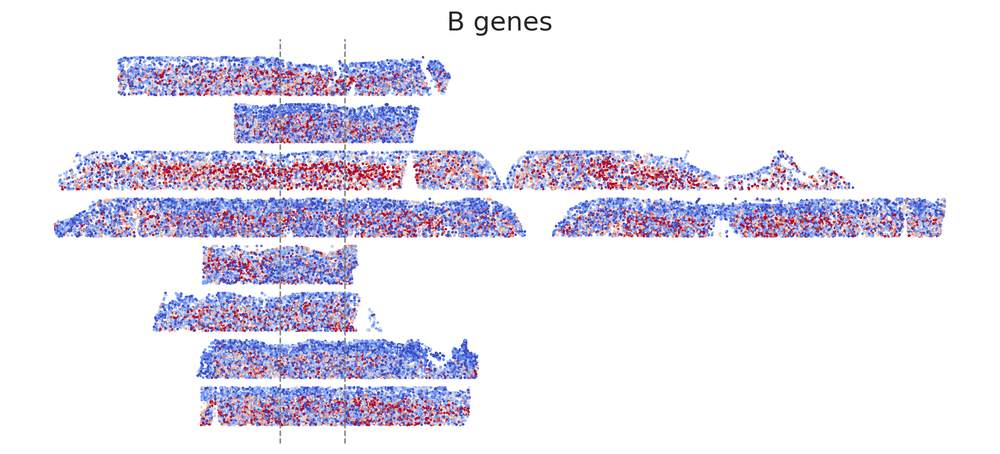

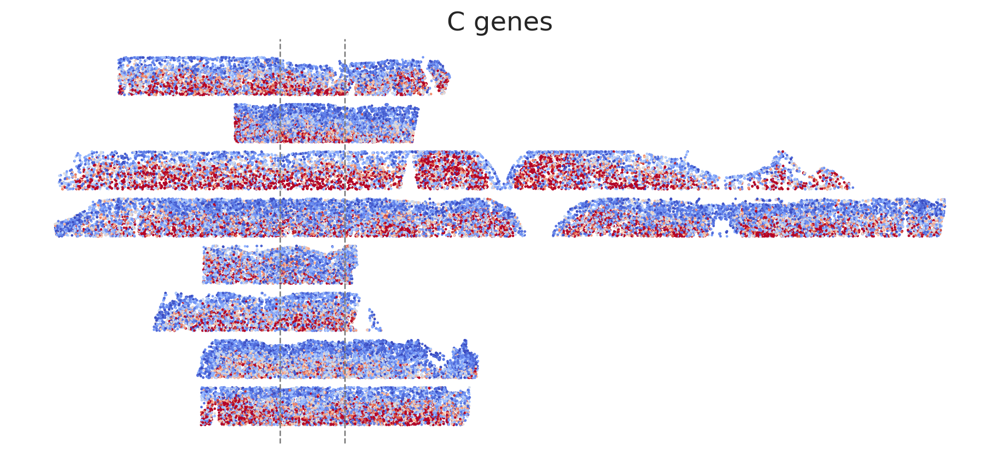

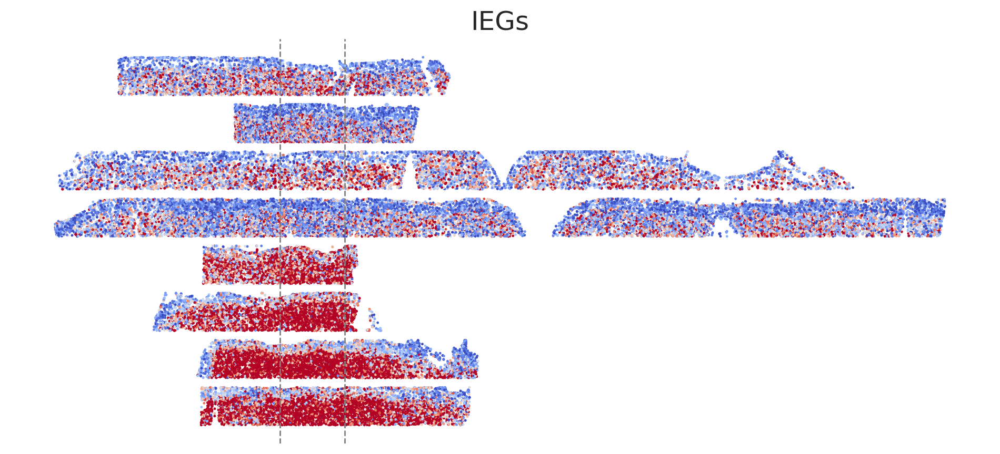

In [16]:
# check
gsets = [agenes, bgenes, cgenes, iegs]
titles = ['A genes', 'B genes', 'C genes', 'IEGs']
# gsets = [['Cdh13', 'Rfx3']]
adata_l23 = adata[adata.obs['depth'] < 400]

x =  adata_l23.obs['width_norm']
y =  adata_l23.obs['depth_show2']
n = len(gns)

for gset, title in zip(gsets, titles):
    
    mat = adata_l23[:,gset].layers['ljnorm']
    baseline = mat.mean(axis=0) # .reshape(-1,)
    
    fig, ax = plt.subplots(1,1,figsize=(1*12,1*5))
    g = (mat-baseline).mean(axis=1) # .reshape(-1,)
    print(g.shape)

    utils_merfish.st_scatter_ax(fig, ax,  x,  y,  gexp=g, s=3, title=title, vmax=0.2, cmap='coolwarm') #, axis_off=False)
    
    ax.set_aspect('auto')
    ax.axvline(0, linewidth=1, color='gray', linestyle='--')
    ax.axvline(1, linewidth=1, color='gray', linestyle='--')
    
    # ax.grid(True)
    # ax.axis('on')
    
plt.show()

# stats

In [17]:
colors = [
    'C1',
    'C1',
    'C1',
    'C1',
    # sns.color_palette('tab20c')[4],
    # sns.color_palette('tab20c')[5],
    'k',
    'k',
    'k',
    'k',
    # 'gray',
]

In [18]:
col_tobin = 'width_norm'
bins = np.arange(-1, 2+1e-3, 0.25)
midbins = np.nanmean(np.vstack([bins[:-1], bins[1:]]), axis=0)
print(bins)

stats = {}
for name in names:
    # adatasub = alldata[name]
    adatasub = adata[adata.obs['sample']==name]
    lnorm_mean, lnorm_sem, lnorm_std, n, binned, bins = binning_pipe2(adatasub, col_tobin, bins=bins)
    stats[name] = (lnorm_mean, lnorm_sem, lnorm_std, n, binned, bins)
    
binned.value_counts()

[-1.   -0.75 -0.5  -0.25  0.    0.25  0.5   0.75  1.    1.25  1.5   1.75
  2.  ]


(-1.0, -0.75]     775
(-0.75, -0.5]    1698
(-0.5, -0.25]    2068
(-0.25, 0.0]     2055
(0.0, 0.25]      1929
(0.25, 0.5]      1990
(0.5, 0.75]      1997
(0.75, 1.0]      1945
(1.0, 1.25]      1991
(1.25, 1.5]      2041
(1.5, 1.75]      1761
(1.75, 2.0]      1864
dtype: int64

In [19]:
# mean expression level across V1 L2/3 in NR
base_a0 = []
base_b0 = []
base_c0 = []
base_i0 = []
for name in [
    'P28NR_ant', 'P28NR_pos', 'P28NRb_ant', 'P28NRb_pos',]:
    (lnorm_mean, lnorm_sem, lnorm_std, n, d, db) = stats[name]
    base_a = np.nanmean(lnorm_mean.iloc[:,agenes_idx], axis=0) # across depth bins for each gene
    base_b = np.nanmean(lnorm_mean.iloc[:,bgenes_idx], axis=0) # across depth bins for each gene
    base_c = np.nanmean(lnorm_mean.iloc[:,cgenes_idx], axis=0) # across depth bins for each gene
    base_i = np.nanmean(lnorm_mean.iloc[:,igenes_idx], axis=0) # across depth bins for each gene
    
    base_a0.append(base_a)
    base_b0.append(base_b)
    base_c0.append(base_c)
    base_i0.append(base_i)
    
base_a0 = np.nanmean(base_a0, axis=0)
base_b0 = np.nanmean(base_b0, axis=0)
base_c0 = np.nanmean(base_c0, axis=0)
base_i0 = np.nanmean(base_i0, axis=0)

base_a0.shape, base_b0.shape, base_c0.shape, base_i0.shape

((64,), (35,), (71,), (22,))

In [20]:
means = {}
sems = {}
for name in names:
    (lnorm_mean, lnorm_sem, lnorm_std, n, d, db) = stats[name]
    
    amean = np.nanmean(lnorm_mean.iloc[:,agenes_idx]-base_a0, axis=1) # a bin vector
    bmean = np.nanmean(lnorm_mean.iloc[:,bgenes_idx]-base_b0, axis=1) # a bin vector
    cmean = np.nanmean(lnorm_mean.iloc[:,cgenes_idx]-base_c0, axis=1) # a bin vector
    imean = np.nanmean(lnorm_mean.iloc[:,igenes_idx]-base_i0, axis=1) # a bin vector
    
    asem = np.nanmean(lnorm_sem.iloc[:,agenes_idx], axis=1)
    bsem = np.nanmean(lnorm_sem.iloc[:,bgenes_idx], axis=1)
    csem = np.nanmean(lnorm_sem.iloc[:,cgenes_idx], axis=1)
    isem = np.nanmean(lnorm_sem.iloc[:,igenes_idx], axis=1)
    
    means[name] = [amean, bmean, cmean, imean]
    sems[name] = [asem, bsem, csem, isem]
    

/tmp/ipykernel_39663/495770233.py:6: RuntimeWarning: Mean of empty slice
  amean = np.nanmean(lnorm_mean.iloc[:,agenes_idx]-base_a0, axis=1) # a bin vector
/tmp/ipykernel_39663/495770233.py:7: RuntimeWarning: Mean of empty slice
  bmean = np.nanmean(lnorm_mean.iloc[:,bgenes_idx]-base_b0, axis=1) # a bin vector
/tmp/ipykernel_39663/495770233.py:8: RuntimeWarning: Mean of empty slice
  cmean = np.nanmean(lnorm_mean.iloc[:,cgenes_idx]-base_c0, axis=1) # a bin vector
/tmp/ipykernel_39663/495770233.py:9: RuntimeWarning: Mean of empty slice
  imean = np.nanmean(lnorm_mean.iloc[:,igenes_idx]-base_i0, axis=1) # a bin vector
/tmp/ipykernel_39663/495770233.py:11: RuntimeWarning: Mean of empty slice
  asem = np.nanmean(lnorm_sem.iloc[:,agenes_idx], axis=1)
/tmp/ipykernel_39663/495770233.py:12: RuntimeWarning: Mean of empty slice
  bsem = np.nanmean(lnorm_sem.iloc[:,bgenes_idx], axis=1)
/tmp/ipykernel_39663/495770233.py:13: RuntimeWarning: Mean of empty slice
  csem = np.nanmean(lnorm_sem.iloc[:,c

In [21]:
samp_gene_dpth_mat = np.array([np.array(means[name]) for name in names]) 
print(samp_gene_dpth_mat.shape) # sample, gene group, depth

nr_mat = samp_gene_dpth_mat[:4]
nr_mean = np.nanmean(nr_mat, axis=0) # gene group, depth
nr_sem  = np.nanstd(nr_mat, axis=0)/np.sqrt(4) # gene group, depth

dr_mat = samp_gene_dpth_mat[4:]
dr_mean = np.nanmean(dr_mat, axis=0) # gene group, depth
dr_sem  = np.nanstd(dr_mat, axis=0)/np.sqrt(4) # gene group, depth
nr_mean.shape, dr_mean.shape

(8, 4, 12)


((4, 12), (4, 12))

In [22]:
2**0.1, 2**0.2, 2**0.3, 2**1

(1.0717734625362931, 1.148698354997035, 1.2311444133449163, 2)

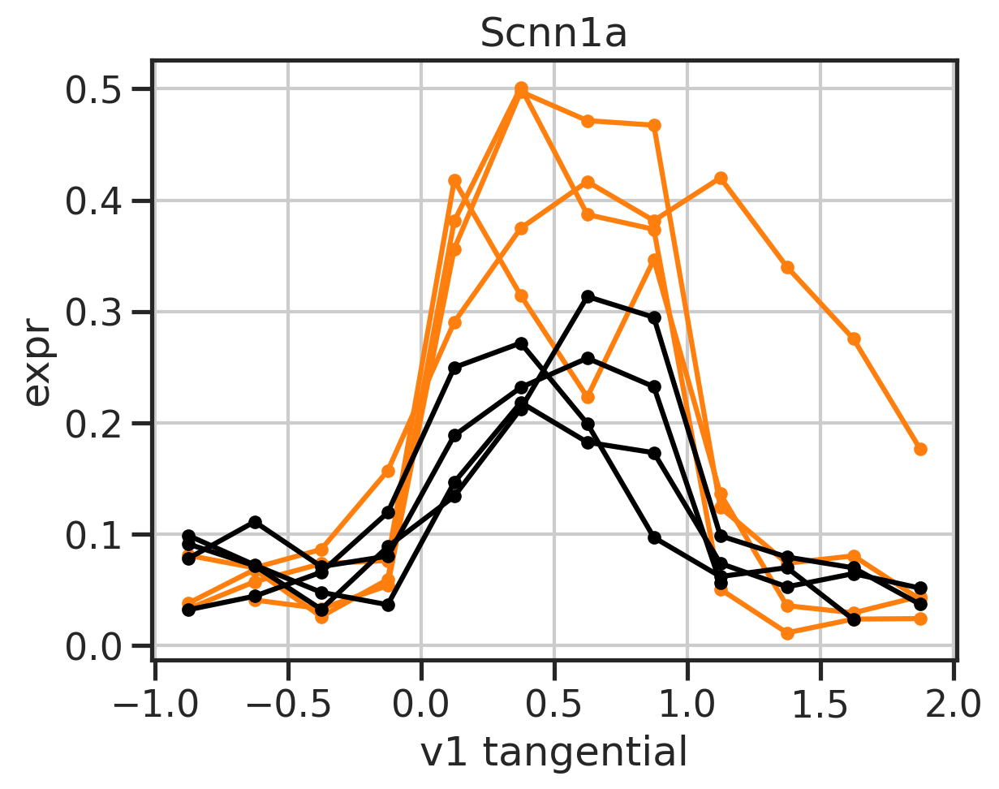

In [23]:
gn = 'Scnn1a'
for name, color in zip(names, colors):
    adatasub = adata[adata.obs['sample']==name]
    adatasub = adatasub[adatasub.obs['depth']<600]
    adatasub = adatasub[adatasub.obs['depth']>400]
    lnorm_mean, lnorm_sem, lnorm_std, n, binned, bins = binning_pipe2(adatasub, col_tobin, bins=bins)
    # (lnorm_mean, lnorm_sem, lnorm_std, n, binned, bins) = stats[name]
    plt.plot(midbins, lnorm_mean[gn], '-o', color=color, markersize=5)
    plt.title(gn)
    plt.xlabel('v1 tangential')
    plt.ylabel('expr')
plt.show()

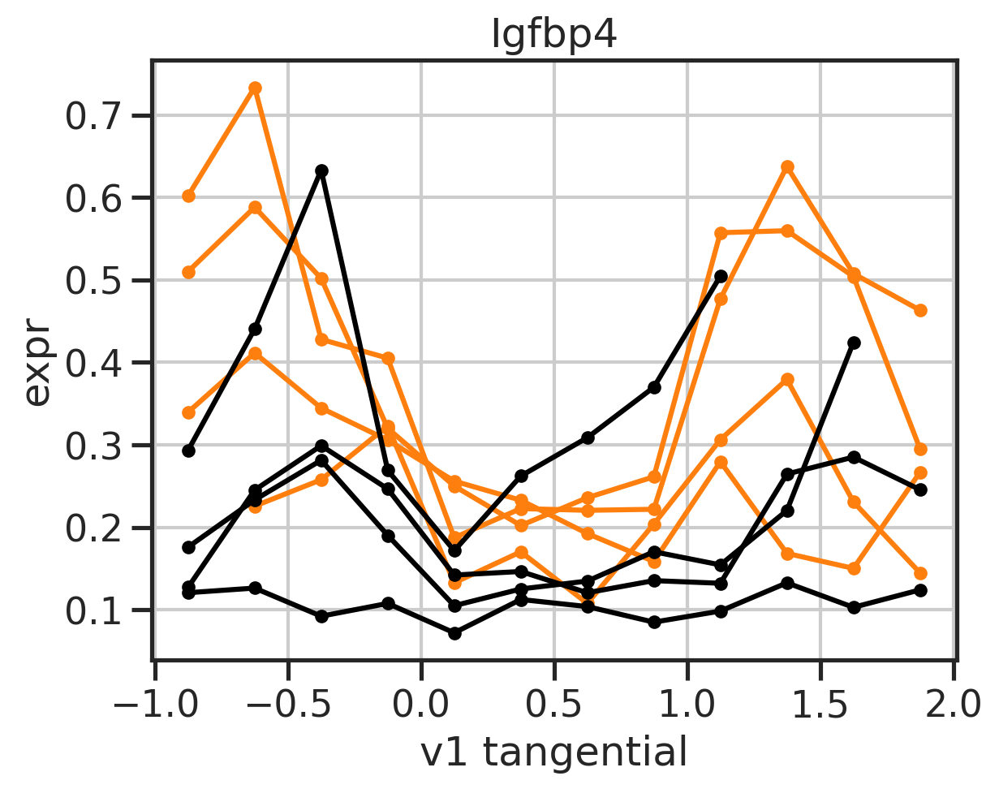

In [24]:
gn = 'Igfbp4'
for name, color in zip(names, colors):
    adatasub = adata[adata.obs['sample']==name]
    adatasub = adatasub[adatasub.obs['depth']<400]
    lnorm_mean, lnorm_sem, lnorm_std, n, binned, bins = binning_pipe2(adatasub, col_tobin, bins=bins)
    # (lnorm_mean, lnorm_sem, lnorm_std, n, binned, bins) = stats[name]
    # plt.plot(midbins, lnorm_mean[gn], '-o')
    plt.plot(midbins, lnorm_mean[gn], '-o', color=color, markersize=5)
    plt.title(gn)
    plt.xlabel('v1 tangential')
    plt.ylabel('expr')
plt.show()

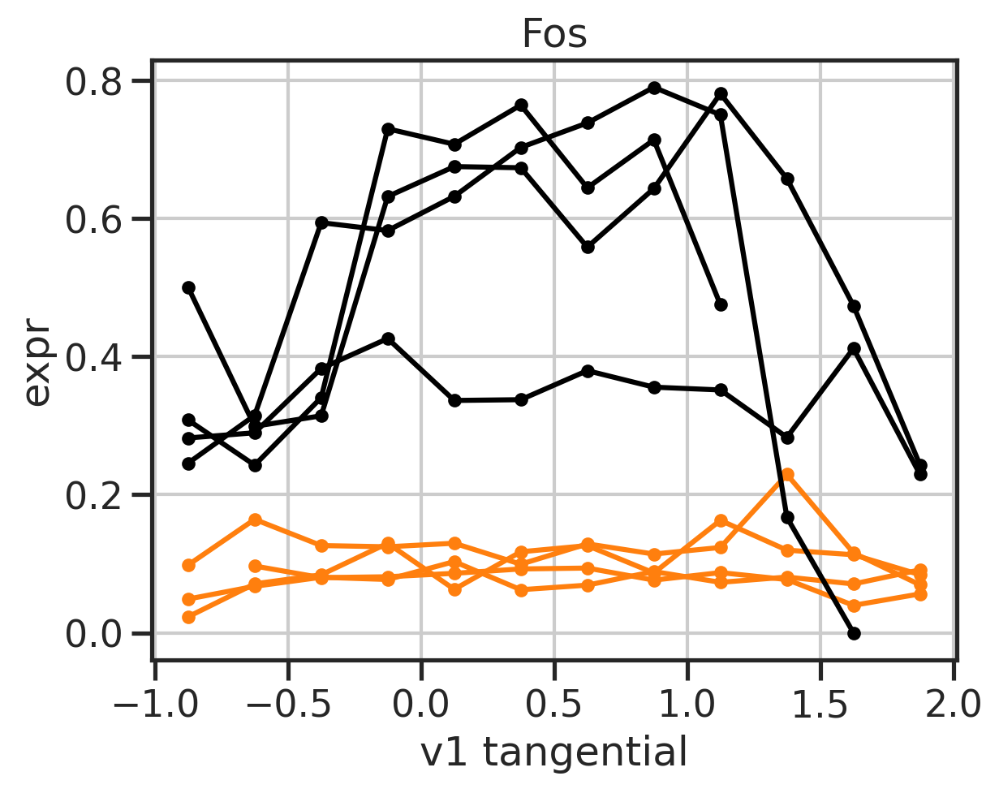

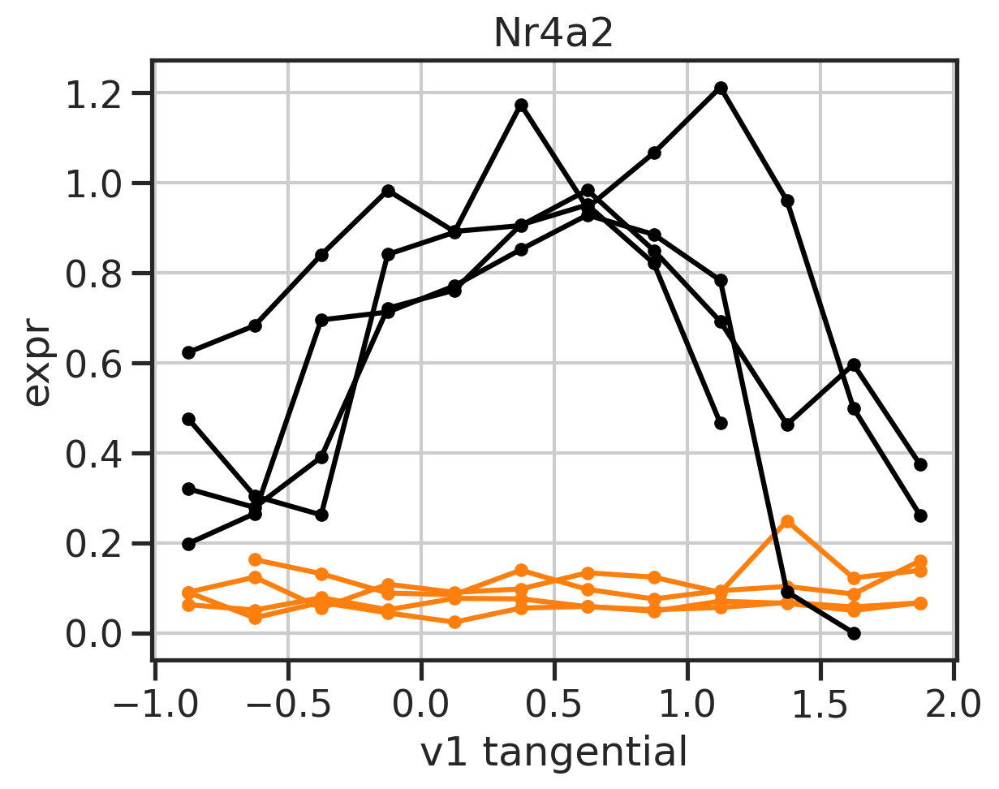

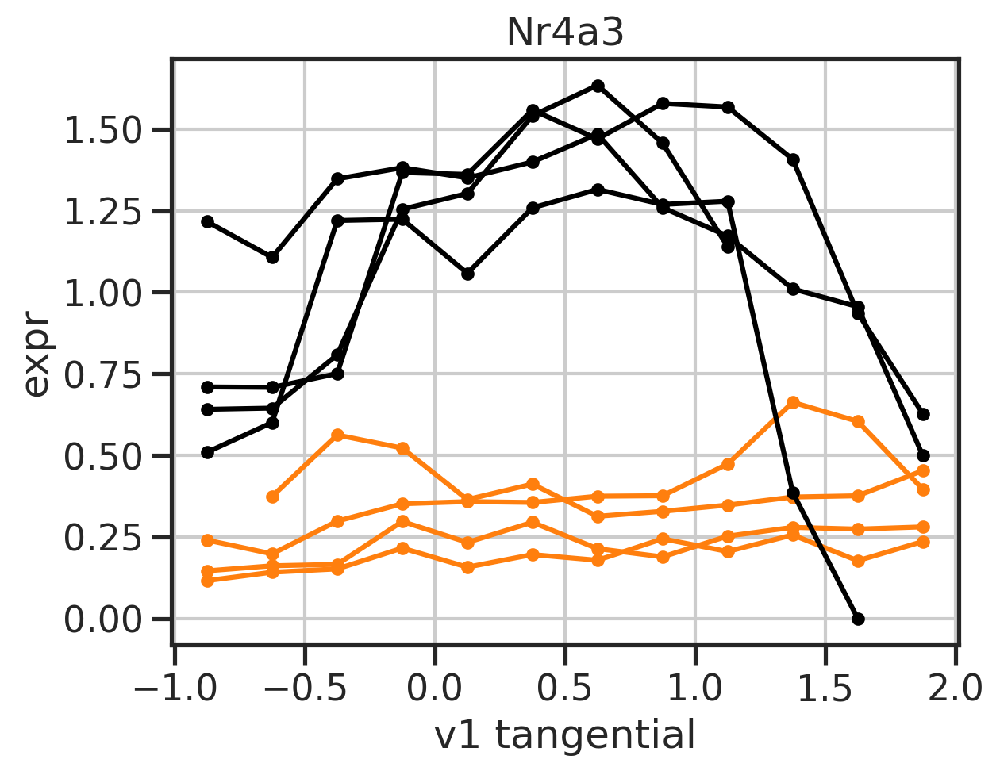

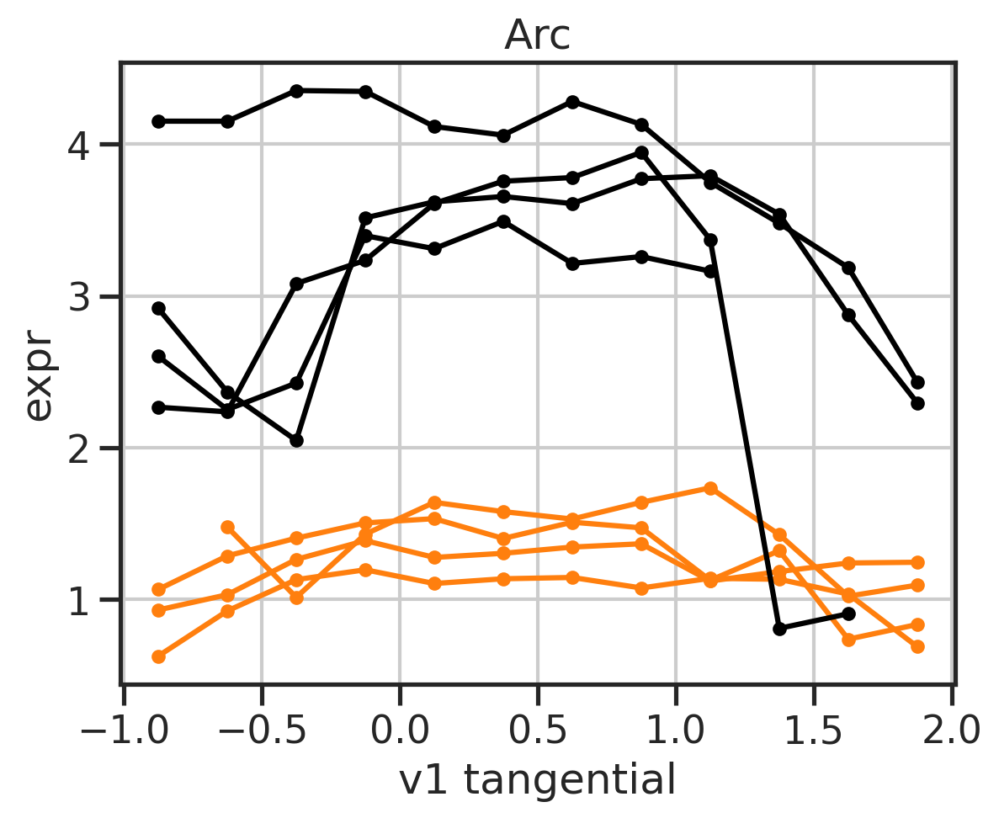

In [25]:
for gn in ['Fos', 'Nr4a2', 'Nr4a3', 'Arc']: #, 'Cdh13', 'Sorcs3', 'Chrm2']:
    for name, color in zip(names, colors):
        adatasub = adata[adata.obs['sample']==name]
        adatasub = adatasub[adatasub.obs['depth']<400]
        lnorm_mean, lnorm_sem, lnorm_std, n, binned, bins = binning_pipe2(adatasub, col_tobin, bins=bins)
        # (lnorm_mean, lnorm_sem, lnorm_std, n, binned, bins) = stats[name]
        plt.plot(midbins, lnorm_mean[gn], '-o', color=color, markersize=5)
        plt.title(gn)
        plt.xlabel('v1 tangential')
        plt.ylabel('expr')
    plt.show()

In [26]:
# 400 ~ 600
lnorm_mean_all = []
for name, color in zip(names, colors):
    adatasub = adata[adata.obs['sample']==name]
    adatasub = adatasub[adatasub.obs['depth']<600]
    adatasub = adatasub[adatasub.obs['depth']>400]
    lnorm_mean, lnorm_sem, lnorm_std, n, binned, bins = binning_pipe2(adatasub, col_tobin, bins=bins)
    lnorm_mean_all.append(lnorm_mean)
lnorm_mean_all = np.array(lnorm_mean_all)

lnorm_mean_nr = np.nanmean(lnorm_mean_all[:4], axis=0)
lnorm_mean_dr = np.nanmean(lnorm_mean_all[4:], axis=0)
lnorm_sem_nr = np.nanstd(lnorm_mean_all[:4], axis=0)/np.sqrt(4)
lnorm_sem_dr = np.nanstd(lnorm_mean_all[:4], axis=0)/np.sqrt(4)

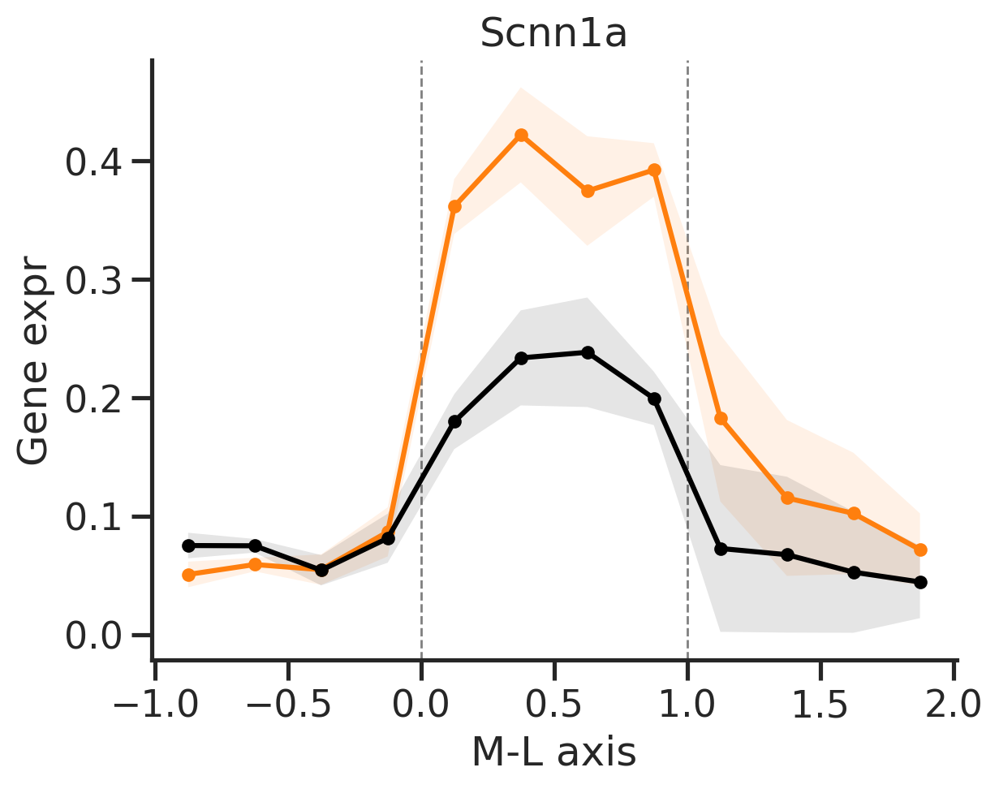

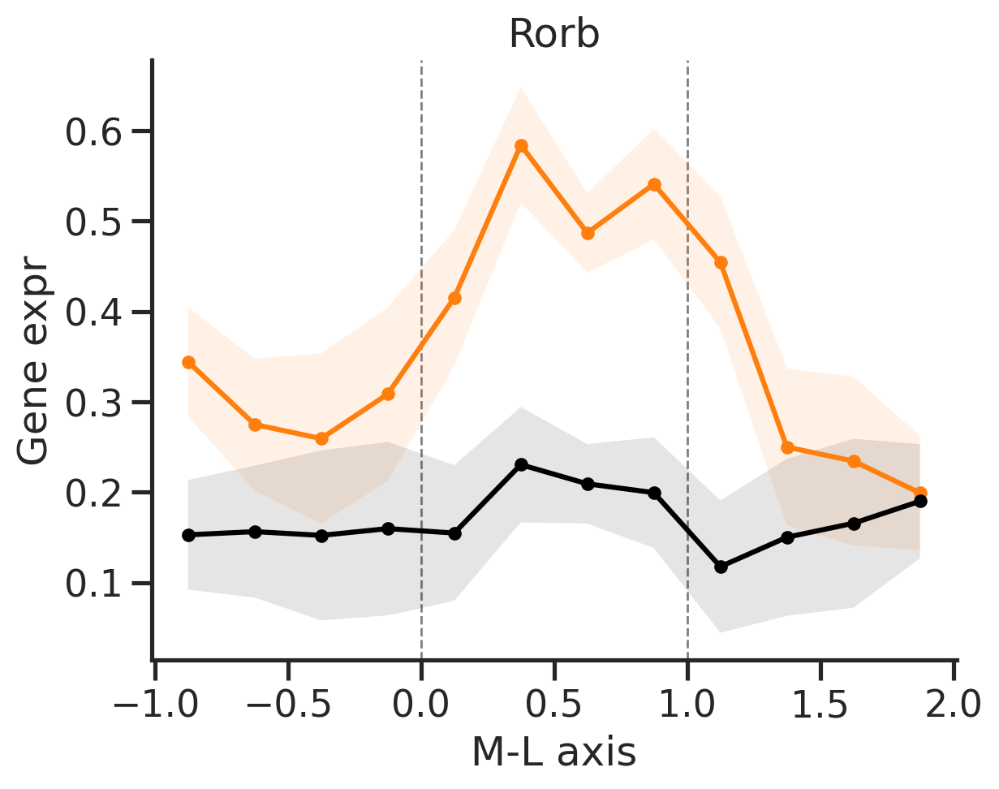

In [27]:
gns = ['Scnn1a', 'Rorb']

for gn in gns:
    # gn = 'Scnn1a'
    gidx = basicu.get_index_from_array(adata.var.index.values, [gn])

    fig, ax = plt.subplots()
    valm = lnorm_mean_nr[:,gidx].reshape(-1,)
    vale = lnorm_sem_nr[:,gidx].reshape(-1,)
    ax.plot(midbins, valm, '-o', markersize=5, color='C1')
    ax.fill_between(midbins, valm-vale, valm+vale, color='C1', alpha=0.1, edgecolor='none')

    valm = lnorm_mean_dr[:,gidx].reshape(-1,)
    vale = lnorm_sem_dr[:,gidx].reshape(-1,)
    ax.plot(midbins, valm, '-o', markersize=5, color='k')
    ax.fill_between(midbins, valm-vale, valm+vale,color='k', alpha=0.1, edgecolor='none')
    sns.despine(ax=ax)
    ax.grid(False)
    ax.axvline(0, linestyle='--', color='gray', zorder=0, linewidth=1)
    ax.axvline(1, linestyle='--', color='gray', zorder=0, linewidth=1)

    ax.set_xlabel('M-L axis')
    ax.set_ylabel('Gene expr')
    ax.set_title(gn)

In [28]:

# < 400
lnorm_mean_all = []
for name, color in zip(names, colors):
    adatasub = adata[adata.obs['sample']==name]
    # adatasub = adatasub[adatasub.obs['depth']<600]
    adatasub = adatasub[adatasub.obs['depth']<400]
    lnorm_mean, lnorm_sem, lnorm_std, n, binned, bins = binning_pipe2(adatasub, col_tobin, bins=bins)
    lnorm_mean_all.append(lnorm_mean)
lnorm_mean_all = np.array(lnorm_mean_all)

lnorm_mean_nr = np.nanmean(lnorm_mean_all[:4], axis=0)
lnorm_mean_dr = np.nanmean(lnorm_mean_all[4:], axis=0)
lnorm_sem_nr = np.nanstd(lnorm_mean_all[:4], axis=0)/np.sqrt(4)
lnorm_sem_dr = np.nanstd(lnorm_mean_all[:4], axis=0)/np.sqrt(4)

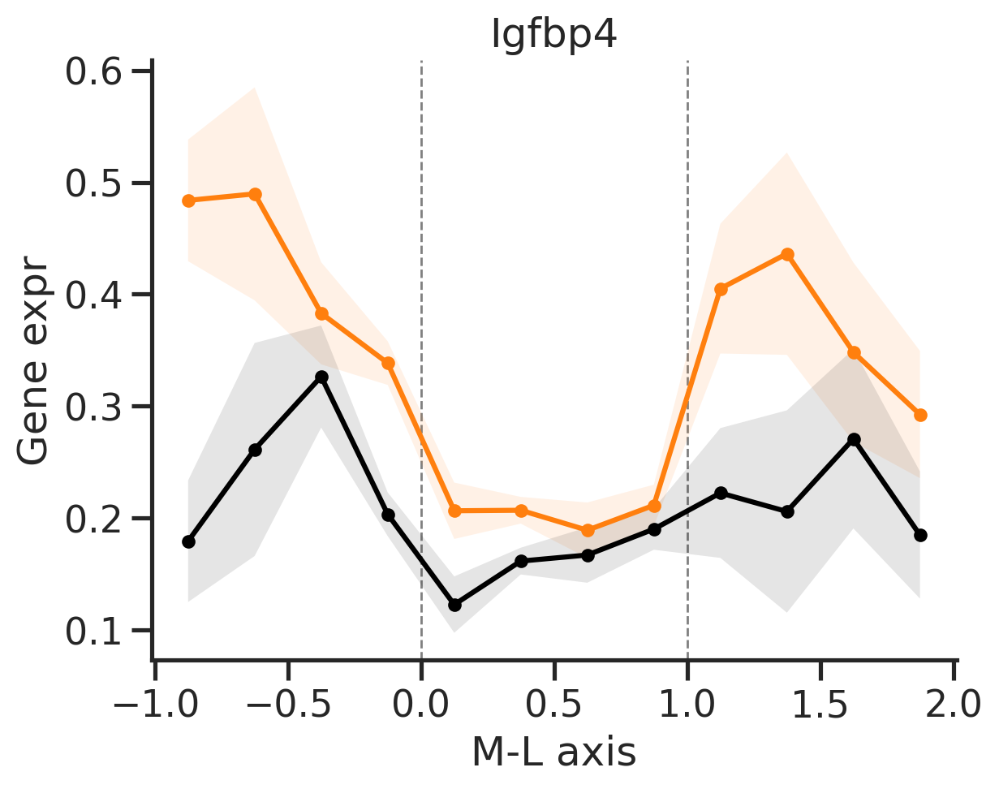

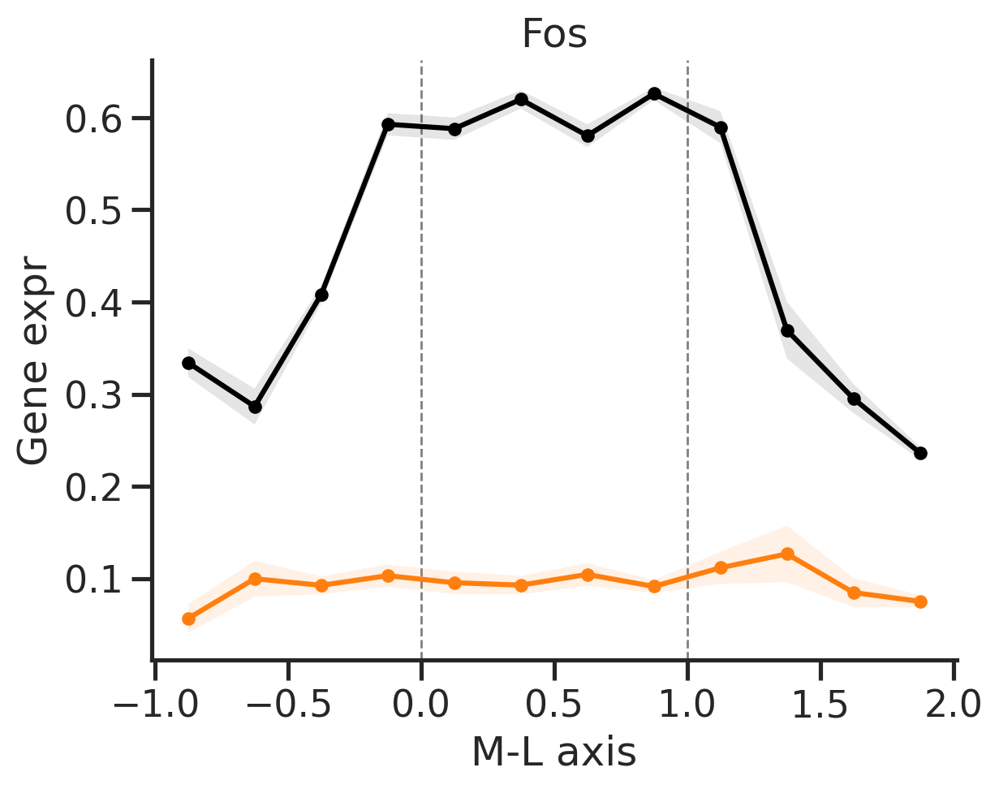

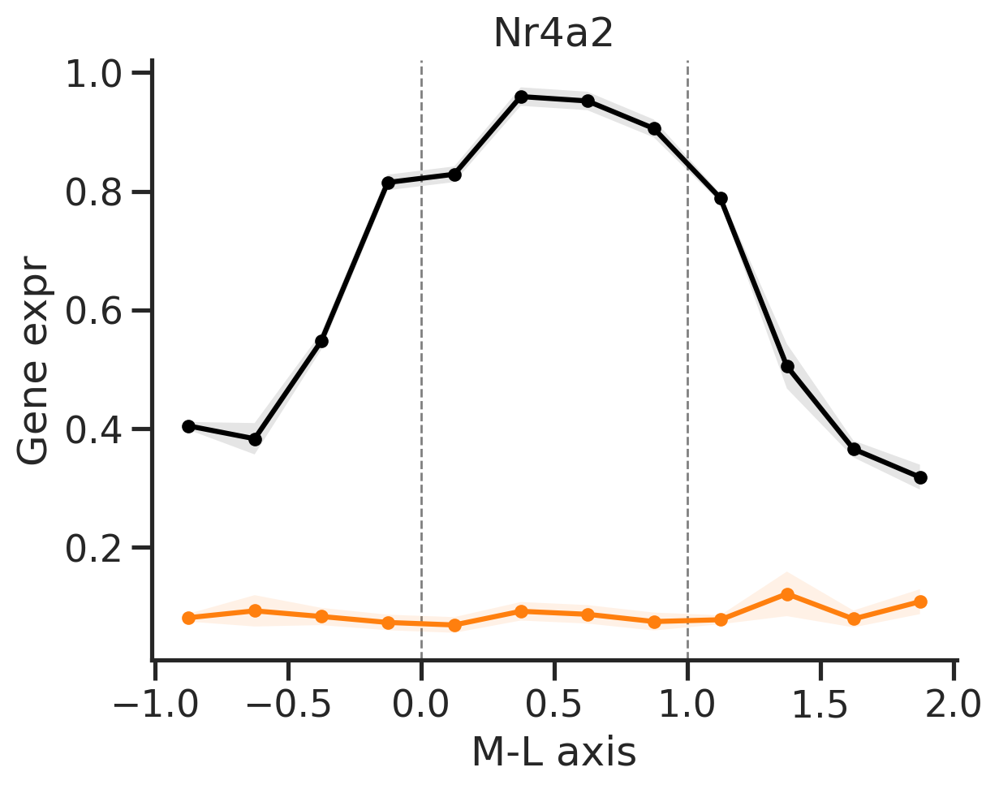

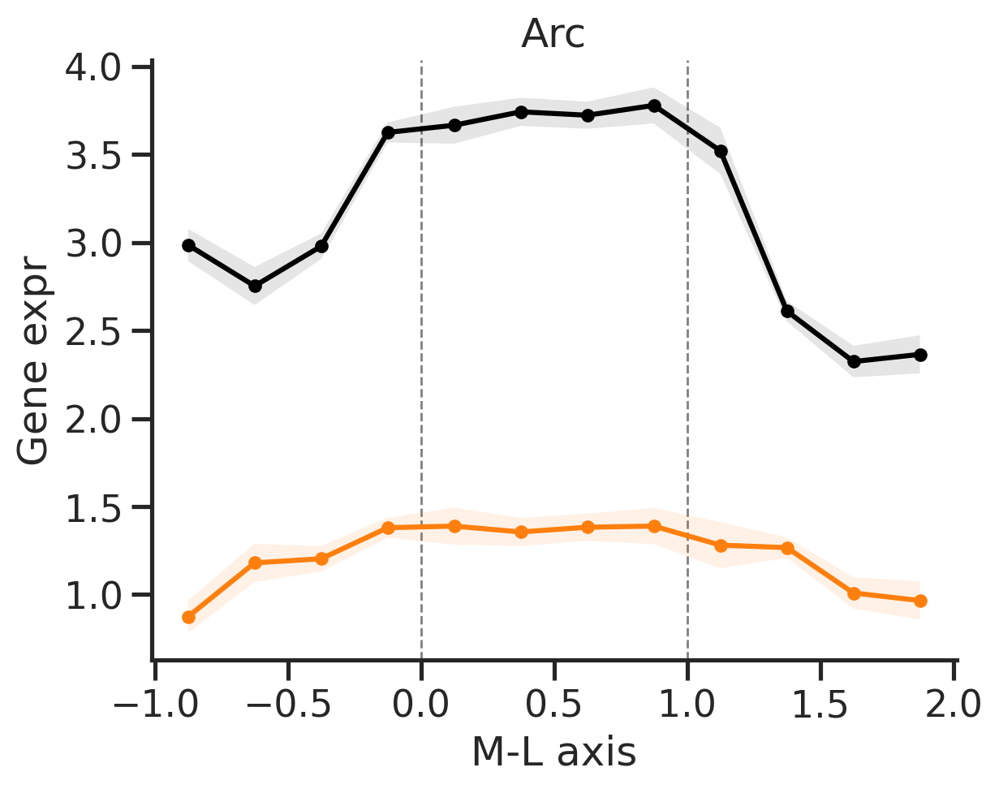

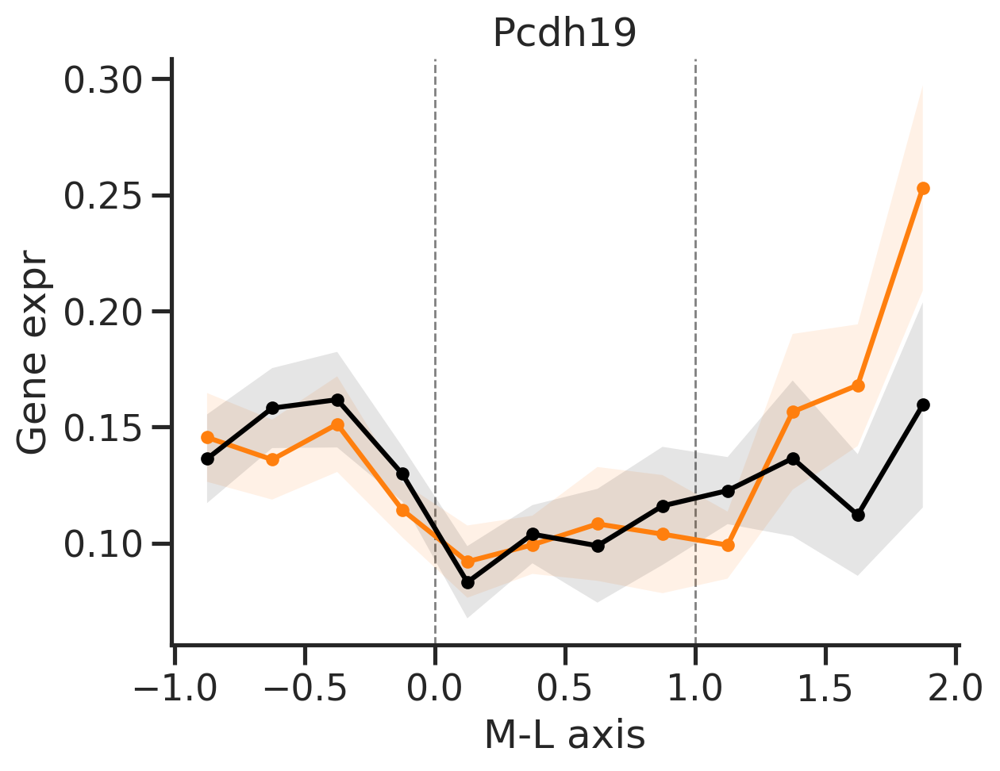

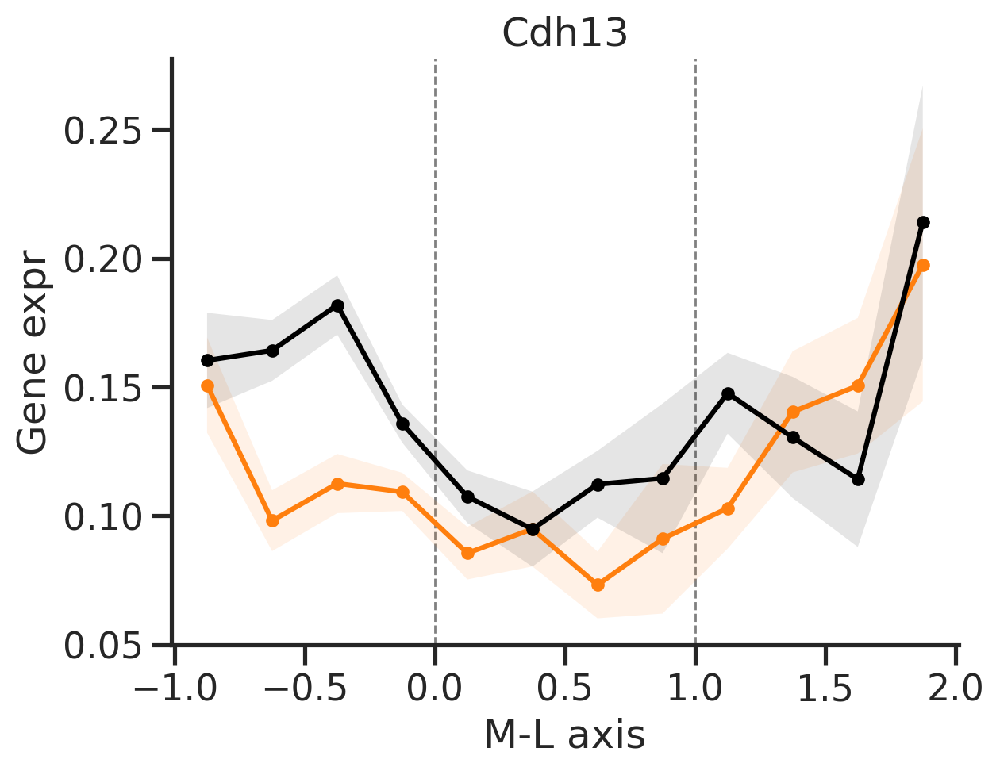

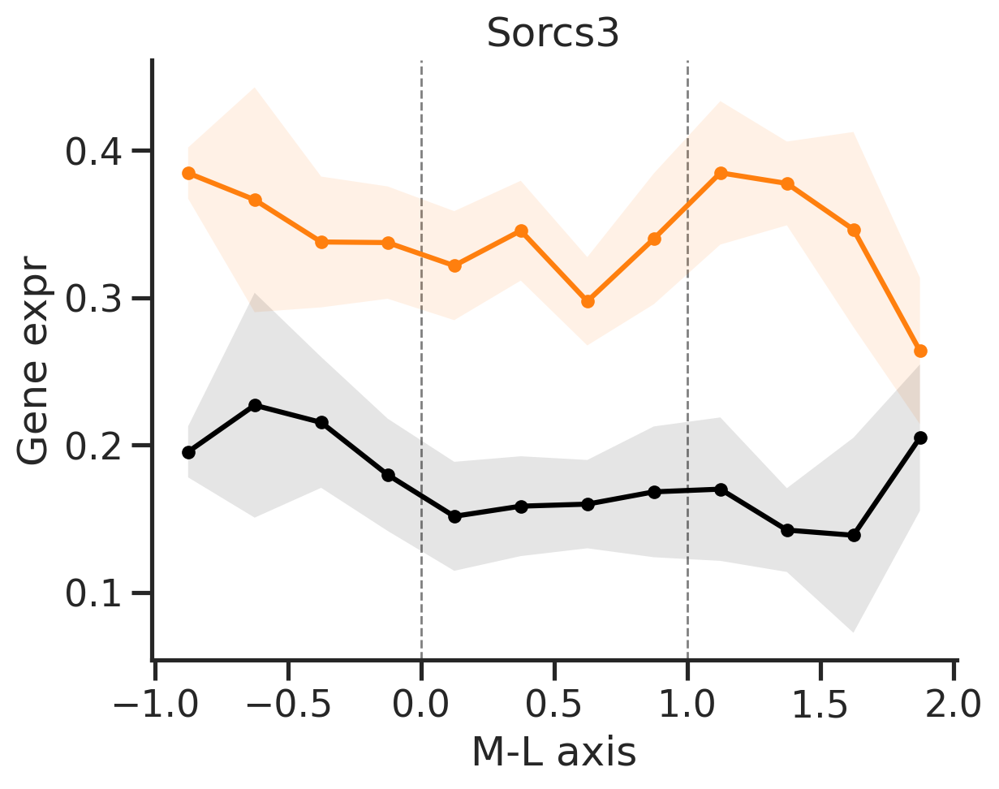

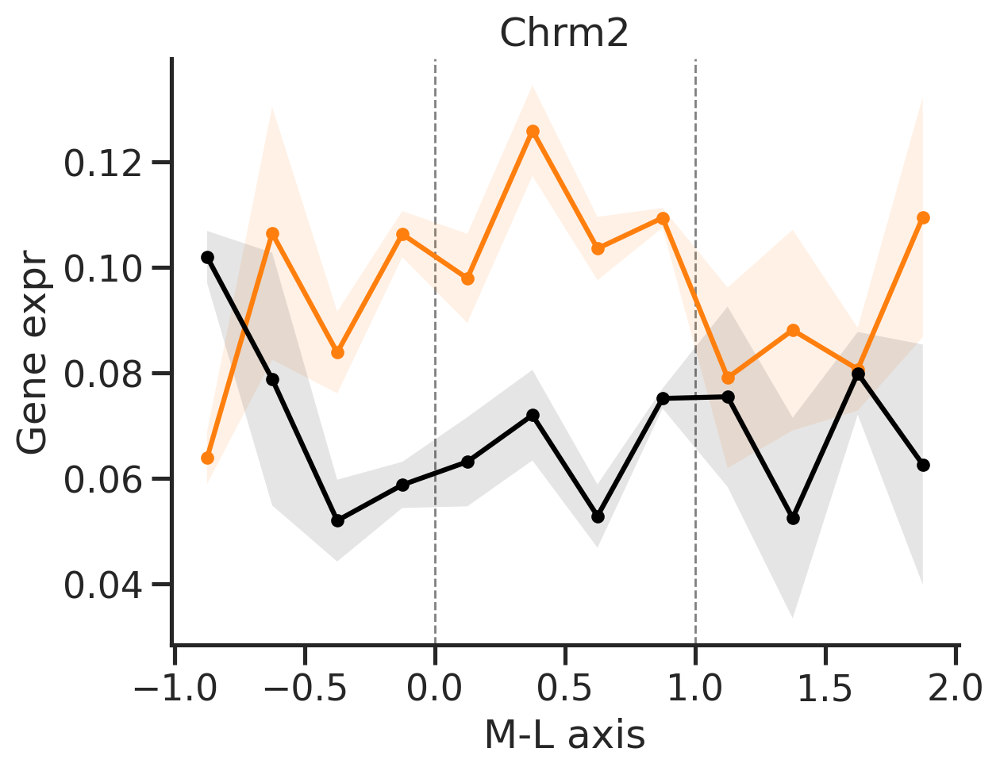

In [29]:
gns = ['Igfbp4', 'Fos', 'Nr4a2', 'Arc', 
       'Pcdh19', 'Cdh13', 'Sorcs3', 'Chrm2',
      ]

for gn in gns:
    # gn = 'Scnn1a'
    gidx = basicu.get_index_from_array(adata.var.index.values, [gn])

    fig, ax = plt.subplots()
    valm = lnorm_mean_nr[:,gidx].reshape(-1,)
    vale = lnorm_sem_nr[:,gidx].reshape(-1,)
    ax.plot(midbins, valm, '-o', markersize=5, color='C1')
    ax.fill_between(midbins, valm-vale, valm+vale, color='C1', alpha=0.1, edgecolor='none')

    valm = lnorm_mean_dr[:,gidx].reshape(-1,)
    vale = lnorm_sem_dr[:,gidx].reshape(-1,)
    ax.plot(midbins, valm, '-o', markersize=5, color='k')
    ax.fill_between(midbins, valm-vale, valm+vale,color='k', alpha=0.1, edgecolor='none')
    sns.despine(ax=ax)
    ax.grid(False)

    ax.axvline(0, linestyle='--', color='gray', zorder=0, linewidth=1)
    ax.axvline(1, linestyle='--', color='gray', zorder=0, linewidth=1)
    ax.set_xlabel('M-L axis')
    ax.set_ylabel('Gene expr')
    ax.set_title(gn)

In [30]:
col_tobin = 'width_norm'
bins = np.arange(-1, 2+1e-3, 0.5)
midbins = np.nanmean(np.vstack([bins[:-1], bins[1:]]), axis=0)
print(bins)

stats = {}
for name in names:
    # adatasub = alldata[name]
    adatasub = adata[adata.obs['sample']==name]
    adatasub = adatasub[adatasub.obs['depth']<400]
    lnorm_mean, lnorm_sem, lnorm_std, n, binned, bins = binning_pipe2(adatasub, col_tobin, bins=bins)
    stats[name] = (lnorm_mean, lnorm_sem, lnorm_std, n, binned, bins)
    
binned.value_counts()

[-1.  -0.5  0.   0.5  1.   1.5  2. ]


(-1.0, -0.5]    1326
(-0.5, 0.0]     1505
(0.0, 0.5]      1294
(0.5, 1.0]      1394
(1.0, 1.5]      1291
(1.5, 2.0]      1298
dtype: int64

In [31]:
# mean expression level across V1 L2/3 in NR
base_a0 = []
base_b0 = []
base_c0 = []
base_i0 = []
for name in [
    'P28NR_ant', 'P28NR_pos', 'P28NRb_ant', 'P28NRb_pos',]:
    (lnorm_mean, lnorm_sem, lnorm_std, n, d, db) = stats[name]
    base_a = np.nanmean(lnorm_mean.iloc[:,agenes_idx], axis=0) # across depth bins for each gene
    base_b = np.nanmean(lnorm_mean.iloc[:,bgenes_idx], axis=0) # across depth bins for each gene
    base_c = np.nanmean(lnorm_mean.iloc[:,cgenes_idx], axis=0) # across depth bins for each gene
    base_i = np.nanmean(lnorm_mean.iloc[:,igenes_idx], axis=0) # across depth bins for each gene
    
    base_a0.append(base_a)
    base_b0.append(base_b)
    base_c0.append(base_c)
    base_i0.append(base_i)
    
base_a0 = np.nanmean(base_a0, axis=0)
base_b0 = np.nanmean(base_b0, axis=0)
base_c0 = np.nanmean(base_c0, axis=0)
base_i0 = np.nanmean(base_i0, axis=0)

base_a0.shape, base_b0.shape, base_c0.shape, base_i0.shape

((64,), (35,), (71,), (22,))

In [32]:
means = {}
sems = {}
for name in names:
    (lnorm_mean, lnorm_sem, lnorm_std, n, d, db) = stats[name]
    
    amean = np.nanmean(lnorm_mean.iloc[:,agenes_idx]-base_a0, axis=1) # a bin vector
    bmean = np.nanmean(lnorm_mean.iloc[:,bgenes_idx]-base_b0, axis=1) # a bin vector
    cmean = np.nanmean(lnorm_mean.iloc[:,cgenes_idx]-base_c0, axis=1) # a bin vector
    imean = np.nanmean(lnorm_mean.iloc[:,igenes_idx]-base_i0, axis=1) # a bin vector
    
    asem = np.nanmean(lnorm_sem.iloc[:,agenes_idx], axis=1)
    bsem = np.nanmean(lnorm_sem.iloc[:,bgenes_idx], axis=1)
    csem = np.nanmean(lnorm_sem.iloc[:,cgenes_idx], axis=1)
    isem = np.nanmean(lnorm_sem.iloc[:,igenes_idx], axis=1)
    
    means[name] = [amean, bmean, cmean, imean]
    sems[name] = [asem, bsem, csem, isem]
    

/tmp/ipykernel_39663/495770233.py:6: RuntimeWarning: Mean of empty slice
  amean = np.nanmean(lnorm_mean.iloc[:,agenes_idx]-base_a0, axis=1) # a bin vector
/tmp/ipykernel_39663/495770233.py:7: RuntimeWarning: Mean of empty slice
  bmean = np.nanmean(lnorm_mean.iloc[:,bgenes_idx]-base_b0, axis=1) # a bin vector
/tmp/ipykernel_39663/495770233.py:8: RuntimeWarning: Mean of empty slice
  cmean = np.nanmean(lnorm_mean.iloc[:,cgenes_idx]-base_c0, axis=1) # a bin vector
/tmp/ipykernel_39663/495770233.py:9: RuntimeWarning: Mean of empty slice
  imean = np.nanmean(lnorm_mean.iloc[:,igenes_idx]-base_i0, axis=1) # a bin vector
/tmp/ipykernel_39663/495770233.py:11: RuntimeWarning: Mean of empty slice
  asem = np.nanmean(lnorm_sem.iloc[:,agenes_idx], axis=1)
/tmp/ipykernel_39663/495770233.py:12: RuntimeWarning: Mean of empty slice
  bsem = np.nanmean(lnorm_sem.iloc[:,bgenes_idx], axis=1)
/tmp/ipykernel_39663/495770233.py:13: RuntimeWarning: Mean of empty slice
  csem = np.nanmean(lnorm_sem.iloc[:,c

In [33]:
samp_gene_dpth_mat = np.array([np.array(means[name]) for name in names]) 
print(samp_gene_dpth_mat.shape) # sample, gene group, depth

nr_mat = samp_gene_dpth_mat[:4]
nr_mean = np.nanmean(nr_mat, axis=0) # gene group, depth
nr_sem  = np.nanstd(nr_mat, axis=0)/np.sqrt(4) # gene group, depth

dr_mat = samp_gene_dpth_mat[4:]
dr_mean = np.nanmean(dr_mat, axis=0) # gene group, depth
dr_sem  = np.nanstd(dr_mat, axis=0)/np.sqrt(4) # gene group, depth
nr_mean.shape, dr_mean.shape

(8, 4, 6)


((4, 6), (4, 6))

In [34]:
midpoints = midbins

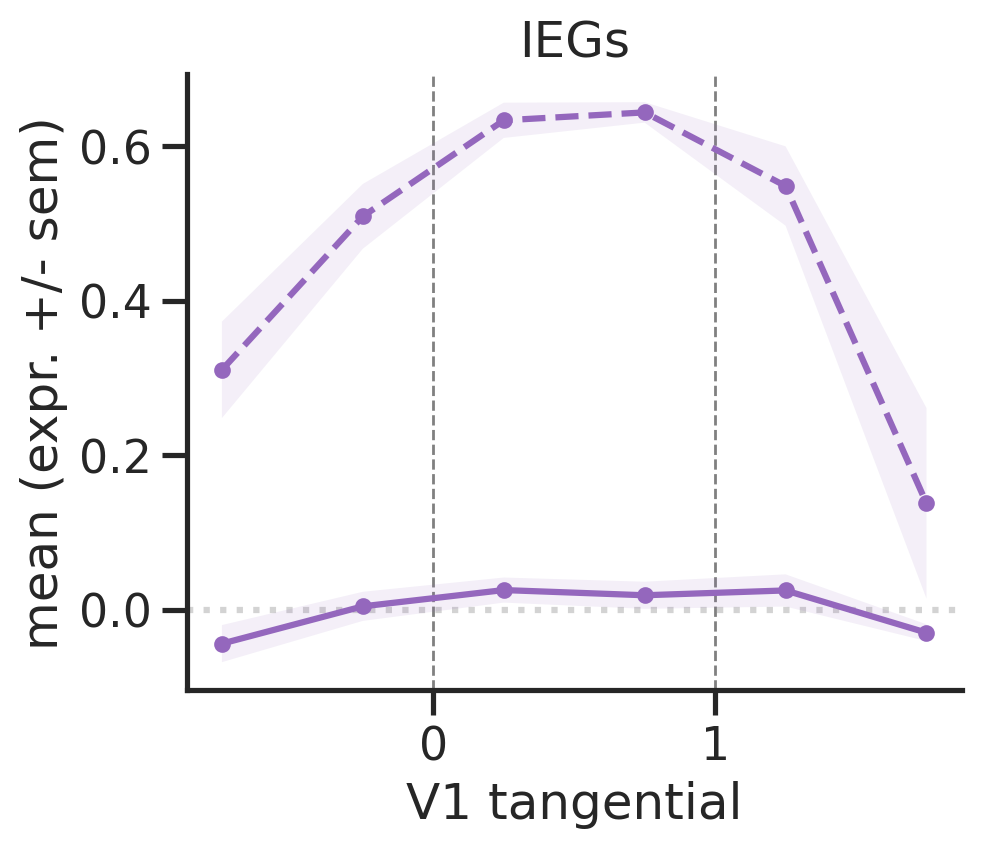

In [35]:
linestyles = ['-', '--']
data_mean = [nr_mean, dr_mean]
data_sem = [nr_sem, dr_sem]
gnames = ['IEGs']
titles = gnames
colors = ['C4']
labels = ['NR', 'DR']
i = 3
# sigs = qs
# allmeans = nrdr_mean

fig, ax = plt.subplots(1, 1, figsize=(5*1,4), sharex=True, sharey=True)
for (gname, color) in zip(gnames, colors):
    ax.axhline(color='lightgray', linestyle='dotted', zorder=1)
    for cond_mean, cond_sem, linestyle in zip(data_mean, data_sem, linestyles):
        ax.plot(midpoints, cond_mean[i], label=gname, color=color, linestyle=linestyle, marker='o', markersize=5)
        ax.fill_between(midpoints, cond_mean[i]-cond_sem[i], cond_mean[i]+cond_sem[i], color=color, alpha=0.1, edgecolor='none')
        
    # for _x, _y, _sig in zip(midpoints, allmeans[i], sigs[i]):
    #     if _sig < 1e-3:
    #         ax.text(_x, _y, "***", ha='left', va='center', fontsize=12, rotation=90)
    #         ax.vlines(_x, _y-0.1, _y+0.1, color='k', linewidth=0.5)
    #     elif _sig < 5e-2:
    #         ax.text(_x, _y, "*", ha='left', va='center', fontsize=12, rotation=90)
    #         ax.vlines(_x, _y-0.1, _y+0.1, color='k', linewidth=0.5)

    sns.despine(ax=ax)
    # ax.set_xticks([0, 100, 200, 300])
    # ax.set_xlim(left=100, right=350)
    # ax.set_ylim([-0.2, 1.2])
    ax.grid(False)
    ax.set_title(gname)
    ax.set_xlabel('V1 tangential')
    ax.axvline(0, linestyle='--', color='gray', zorder=0, linewidth=1)
    ax.axvline(1, linestyle='--', color='gray', zorder=0, linewidth=1)
    
ax.set_ylabel('mean (expr. +/- sem)')
fig.subplots_adjust(wspace=0.1)
# powerplots.savefig_autodate(fig, outdatadir+'/grant_saumya_lineq_abc_v3.pdf')
plt.show()

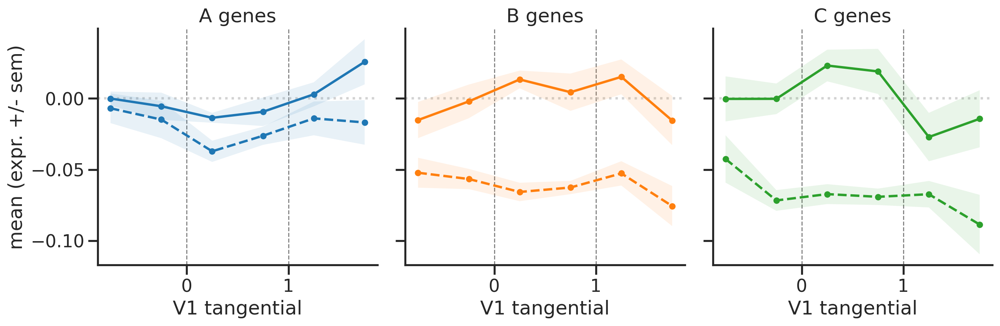

In [36]:
linestyles = ['-', '--']
data_mean = [nr_mean, dr_mean]
data_sem = [nr_sem, dr_sem]
gnames = ['A genes', 'B genes', 'C genes']
titles = gnames
colors = ['C0', 'C1', 'C2']
labels = ['NR', 'DR']
# sigs = qs
# allmeans = nrdr_mean

fig, axs = plt.subplots(1, 3, figsize=(5*3,4), sharex=True, sharey=True)
for i, (ax, gname, color) in enumerate(zip(axs, gnames, colors)):
    ax.axhline(color='lightgray', linestyle='dotted', zorder=1)
    for cond_mean, cond_sem, title, linestyle in zip(data_mean, data_sem, titles, linestyles):
        ax.plot(midpoints, cond_mean[i], label=gname, color=color, linestyle=linestyle, marker='o', markersize=5)
        ax.fill_between(midpoints, cond_mean[i]-cond_sem[i], cond_mean[i]+cond_sem[i], color=color, alpha=0.1, edgecolor='none')
        
    # for _x, _y, _sig in zip(midpoints, allmeans[i], sigs[i]):
    #     if _sig < 1e-3:
    #         ax.text(_x, _y, "***", ha='left', va='center', fontsize=12, rotation=90)
    #         ax.vlines(_x, _y-0.02, _y+0.02, color='k', linewidth=0.5)
    #     elif _sig < 5e-2:
    #         ax.text(_x, _y, "*", ha='left', va='center', fontsize=12, rotation=90)
    #         ax.vlines(_x, _y-0.02, _y+0.02, color='k', linewidth=0.5)

    sns.despine(ax=ax)
    # ax.set_xticks([0, 100, 200, 300])
    # ax.set_xlim(left=100, right=350)
    # ax.set_ylim([-0.2, 0.3])
    ax.grid(False)
    ax.set_title(gname)
    ax.set_xlabel('V1 tangential')
    ax.axvline(0, linestyle='--', color='gray', zorder=0, linewidth=1)
    ax.axvline(1, linestyle='--', color='gray', zorder=0, linewidth=1)
    
axs[0].set_ylabel('mean (expr. +/- sem)')
fig.subplots_adjust(wspace=0.1)
# powerplots.savefig_autodate(fig, outdatadir+'/grant_saumya_lineq_abc_v3.pdf')
plt.show()

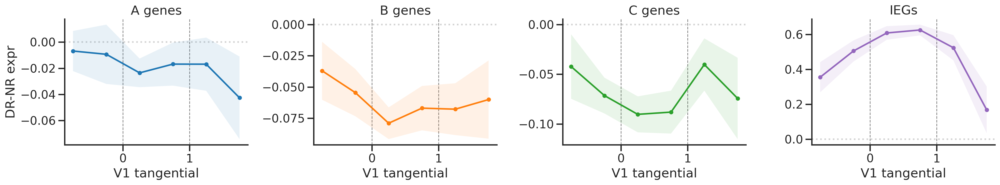

In [37]:
linestyles = ['-', '--']
data_mean = [nr_mean, dr_mean]
data_sem = [nr_sem, dr_sem]
gnames = ['A genes', 'B genes', 'C genes', 'IEGs']
titles = gnames
colors = ['C0', 'C1', 'C2', 'C4']
labels = ['NR', 'DR']
# sigs = qs
# allmeans = nrdr_mean

fig, axs = plt.subplots(1, 4, figsize=(5*4,4)) #, sharex=True, sharey=True)
for i, (ax, gname, color) in enumerate(zip(axs, gnames, colors)):
    ax.axhline(color='lightgray', linestyle='dotted', zorder=1)
    val  = data_mean[1][i]-data_mean[0][i]
    valr = data_sem[1][i]+data_sem[0][i]
    
    ax.plot(midpoints, val, '-o', color=color, markersize=5)
    ax.fill_between(midpoints, val-valr, val+valr, color=color, alpha=0.1, edgecolor='none')
    
    # for cond_mean, cond_sem, title, linestyle in zip(data_mean, data_sem, titles, linestyles):
    #     ax.plot(midpoints, cond_mean[i], label=gname, color=color, linestyle=linestyle, marker='o', markersize=5)
    #     ax.fill_between(midpoints, cond_mean[i]-cond_sem[i], cond_mean[i]+cond_sem[i], color=color, alpha=0.1, edgecolor='none')
        
    # for _x, _y, _sig in zip(midpoints, allmeans[i], sigs[i]):
    #     if _sig < 1e-3:
    #         ax.text(_x, _y, "***", ha='left', va='center', fontsize=12, rotation=90)
    #         ax.vlines(_x, _y-0.02, _y+0.02, color='k', linewidth=0.5)
    #     elif _sig < 5e-2:
    #         ax.text(_x, _y, "*", ha='left', va='center', fontsize=12, rotation=90)
    #         ax.vlines(_x, _y-0.02, _y+0.02, color='k', linewidth=0.5)

    sns.despine(ax=ax)
    # ax.set_xticks([0, 100, 200, 300])
    # ax.set_xlim(left=100, right=350)
    # ax.set_ylim([-0.2, 0.3])
    ax.grid(False)
    ax.set_title(gname)
    ax.set_xlabel('V1 tangential')
    ax.axvline(0, linestyle='--', color='gray', zorder=0, linewidth=1)
    ax.axvline(1, linestyle='--', color='gray', zorder=0, linewidth=1)
    
axs[0].set_ylabel('DR-NR expr')
# fig.subplots_adjust(wspace=0.1)
fig.tight_layout()
# powerplots.savefig_autodate(fig, outdatadir+'/grant_saumya_lineq_abc_v3.pdf')
plt.show()